In [1]:
# full width
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

import os
import numpy as np
import pandas as pd
from tqdm.auto import tqdm
import torch
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import cv2

ch_path = '/media/mikolaj/HDD/ml_data/local_prototypes/2022_10_09_resnet_34_layer4/pruned_prototypes_k6_pt3/prune_last0.7732.pth'

model = torch.load(ch_path)
model = model.cuda()

In [2]:
from torchvision import transforms
from preprocess import mean, std
from settings import img_size
from cleverhans.torch.attacks.projected_gradient_descent import projected_gradient_descent
from torch import nn
import torch.nn.functional as F
from helpers import find_high_activation_crop
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import RawScoresOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from torchvision.models import resnet50
from train_and_test import joint


N_SAMPLES = 400
NUM_PATCHES = 7

EPSILON = 0.1
EPSILON_ITER = 0.005
NB_ITER = 50


cam_layers = {
    'add_on': [model.add_on_layers],
    'add_on_last_layer': [model.add_on_layers[-1]],
    'last_conv_layer': [model.features.layer4[-1]],
    'last_conv_block': [model.features.layer4],
    'first_conv_block': [model.features.layer1],
    'all_last_conv_layers': [model.features.layer1[-1], model.features.layer2[-1], model.features.layer3[-1], model.features.layer4[-1]],
    'all_conv_blocks': [model.features.layer1, model.features.layer2, model.features.layer3, model.features.layer4],
    'all': [model.features.layer1, model.features.layer2, model.features.layer3, model.features.layer4, model.add_on_layers],
}


def generate_adversarial_examples(method):
    class GradCamWrapper(nn.Module):
        def __init__(self, model, proto_num):
            super(GradCamWrapper, self).__init__()        
            self.model = model
            self.proto_num = proto_num

        def forward(self, x):
            distances = self.model.prototype_distances(x)
            # global min pooling
            min_distances = -F.max_pool2d(-distances,
                                          kernel_size=(distances.size()[2],
                                                       distances.size()[3]))
            min_distances = min_distances.view(-1, self.model.num_prototypes)
            prototype_activations = self.model.distance_2_similarity(min_distances)
            
            return prototype_activations[:, self.proto_num]
    
    class PPNetAdversarialWrapper(nn.Module):
        def __init__(self, model, img, proto_num, i, j):
            super(PPNetAdversarialWrapper, self).__init__()        
            self.model = model
            self.proto_num = proto_num
            self.i = i
            self.j = j

            self.img = img.clone()
            self.img.requires_grad = False
            self.mask = torch.zeros_like(img)

            for i2 in range(NUM_PATCHES):
                for j2 in range(NUM_PATCHES):
                    if abs(i2-i) < 2 and abs(j2-j) < 2:
                        continue

                    self.mask[:, :, i2*patch_size:(i2+1)*patch_size, 
                              j2*patch_size:(j2+1)*patch_size] = 1

            self.mask.requires_grad = False

        def forward(self, x):
            x2 = x * self.mask + self.img * (1 - self.mask)

            conv_output, distances = self.model.push_forward(x2)
            return distances[:, self.proto_num]

    transform_img = transforms.Compose([
        transforms.Resize(size=(img_size, img_size)),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    all_data = []


    valid_dir = '/media/mikolaj/HDD/ml_data/birds/test_birds/test_birds/test_birds/'

    all_classes = os.listdir(valid_dir)

    proto_cls_map = model.prototype_class_identity.cpu().detach().numpy()

    original_correct = 0
    modified_correct = 0

    
    all_classes = 10 * all_classes

    for cls_dir in tqdm(all_classes[:N_SAMPLES], desc=f'generating {method} examples'):    
        cls_num = int(cls_dir.split('.')[0]) - 1
        cls_protos = np.argwhere(proto_cls_map[:, cls_num] == 1).flatten()

        img_file = np.random.choice(os.listdir(os.path.join(valid_dir, cls_dir)))

        img_path = os.path.join(valid_dir, cls_dir, img_file)

        img = Image.open(img_path).convert('RGB')
        img_numpy = np.asarray(img)
        img_numpy = cv2.resize(img_numpy, dsize=(img_size, img_size), interpolation=cv2.INTER_CUBIC)
    
        patch_size = int(img_numpy.shape[0]/NUM_PATCHES)

        img_tensor = transform_img(Image.fromarray(img_numpy)).cuda().unsqueeze(0)

        cam_results_original = {}
        cam_results_modified = {}
        
        
        with torch.no_grad():     
            _, patch_distance = model.push_forward(img_tensor)

            # get model prediction for the ground truth class
            min_distances = -F.max_pool2d(-patch_distance,
                                          kernel_size=(patch_distance.size()[2],
                                                       patch_distance.size()[3]))
            min_distances = min_distances.view(-1, model.num_prototypes)
            prototype_activations = model.distance_2_similarity(min_distances)

            original_pred = torch.softmax(model.last_layer(prototype_activations), dim=-1)[0]

            is_correct = torch.argmax(original_pred).item() == cls_num
            if is_correct:
                original_correct += 1

            original_cls_pred = original_pred[cls_num].item()  

            patch_activation = model.distance_2_similarity(patch_distance)

            max_all_proto_act, _ = torch.max(patch_activation.flatten(start_dim=2), dim=-1)

            patch_activation = patch_activation.cpu().detach().numpy()
                        
            proto_argmax = np.nonzero(patch_activation==patch_activation.max())
            proto_num = proto_argmax[1][0]
            
            patch_activation = patch_activation[0, proto_num]

            argmax_act = np.unravel_index(patch_activation.argmax(), patch_activation.shape)
            max_act = np.max(patch_activation)

            n_more_activated = torch.sum(max_all_proto_act > max_act).item()
            original_proto_place = n_more_activated + 1

            upsampled_activation = cv2.resize(patch_activation, 
                                              dsize=(img_tensor.shape[2], img_tensor.shape[3]),
                                              interpolation=cv2.INTER_CUBIC)
            upsampled_activation_original = upsampled_activation

            high_act_original = find_high_activation_crop(upsampled_activation_original)

        # plt.figure(figsize=(5, 5))
        # plt.title(f'Maximum activation in patch {argmax_act}: {max_act:.2f}\nClass prediction: {original_cls_pred:.2f}')
        # plt.imshow(overlayed_img, vmin=0, vmax=1)
        # plt.axis('off')
        # plt.show()

        img_tensor = transform_img(Image.fromarray(img_numpy)).cuda().unsqueeze(0)

        min_act_modified = max_act
        min_act_pred = original_cls_pred
        min_act_modified_patch = None
        min_act_proto_place = original_proto_place
        is_correct_modified = is_correct
        new_cls_pred = original_cls_pred

        # prog_bar = tqdm(total=(NUM_PATCHES-2)**2, desc='finding best adversarial patch')

            
        if method == 'adversarial':
            model_wrapped = PPNetAdversarialWrapper(model, img_tensor, proto_num, 
                                                    argmax_act[0], argmax_act[1])
            img_modified = projected_gradient_descent(model_wrapped, img_tensor, EPSILON, EPSILON_ITER, NB_ITER, np.inf)
            img_modified = img_modified * model_wrapped.mask + model_wrapped.img * (1 - model_wrapped.mask)
            img_modified_numpy = img_modified[0].cpu().detach().numpy()
            img_modified_numpy = img_modified_numpy.transpose(1, 2, 0)
        
        elif method == 'frame':
            img_modified_numpy = img_tensor.clone()[0].cpu().detach().numpy()
            img_modified_numpy = img_modified_numpy.transpose(1, 2, 0) 
            
            FRAME_SIZE = 10
            
            img_modified_numpy[:FRAME_SIZE] = 0
            img_modified_numpy[-FRAME_SIZE:] = 0
            img_modified_numpy[:, :FRAME_SIZE] = 0
            img_modified_numpy[:, -FRAME_SIZE:] = 0
            
        elif method == 'gray_out':
            img_modified_numpy = img_tensor.clone()[0].cpu().detach().numpy()
            img_modified_numpy = img_modified_numpy.transpose(1, 2, 0) 
            
            EPSILON_GRAY = 20
                       
            img_modified_numpy[:max(high_act_original[0]-EPSILON_GRAY, 0)] = 0
            img_modified_numpy[min(high_act_original[1]+EPSILON_GRAY, img_size-1):] = 0
            img_modified_numpy[:, :max(high_act_original[2]-EPSILON_GRAY, 0)] = 0
            img_modified_numpy[:, min(high_act_original[3]+EPSILON_GRAY, img_size-1):] = 0            
            
        else:
            raise ValueError(method)
        
        
        for p in model.features.parameters():
            p.requires_grad = True
        for p in model.add_on_layers.parameters():
            p.requires_grad = True
        model.prototype_vectors.requires_grad = True
        for p in model.last_layer.parameters():
            p.requires_grad = True
        

        model_wrapped = GradCamWrapper(model, proto_num)
        
        for layer_keys, layers in cam_layers.items():
            cam = GradCAM(model=model_wrapped, target_layers=layers, use_cuda=True)

            targets = [RawScoresOutputTarget()]

            # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
            grayscale_cam = cam(input_tensor=img_tensor, targets=targets)

            # In this example grayscale_cam has only one image in the batch:
            grayscale_cam = grayscale_cam[0, :]

            high_acc_cam = find_high_activation_crop(grayscale_cam)
            visualization = show_cam_on_image(img_numpy / 256, grayscale_cam, use_rgb=True)        

            cam_results_original[layer_keys] = {'high_act': high_acc_cam, 'img': visualization}

        img_modified_numpy = (img_modified_numpy * std + mean) * 255
        img_modified_numpy = img_modified_numpy.clip(0, 255).astype(np.uint8)

        img_modified = transform_img(Image.fromarray(img_modified_numpy)).cuda().unsqueeze(0)

        with torch.no_grad():
            _, patch_distance = model.push_forward(img_modified)
                        
             # get model prediction for the ground truth class
            min_distances = -F.max_pool2d(-patch_distance,
                                          kernel_size=(patch_distance.size()[2],
                                                       patch_distance.size()[3]))
            min_distances = min_distances.view(-1, model.num_prototypes)
            prototype_activations = model.distance_2_similarity(min_distances)

            new_pred = torch.softmax(model.last_layer(prototype_activations), dim=-1)[0]
            new_cls_pred = new_pred[cls_num].item()  

            patch_activation = model.distance_2_similarity(patch_distance)
            max_all_proto_act, _ = torch.max(patch_activation.flatten(start_dim=2), dim=-1)

            patch_activation = patch_activation.cpu().detach().numpy()
            patch_activation = patch_activation[0, proto_num]

            new_act = patch_activation[argmax_act[0], argmax_act[1]]

            is_correct_modified = torch.argmax(new_pred).item() == cls_num

            min_act_modified = new_act
            min_act_pred = new_cls_pred

            upsampled_activation = cv2.resize(patch_activation, 
                                              dsize=(img_tensor.shape[2], img_tensor.shape[3]),
                                              interpolation=cv2.INTER_CUBIC)
            high_act = find_high_activation_crop(upsampled_activation)
            rescaled_act = upsampled_activation

            norm_min = min(np.amin(upsampled_activation), np.amin(upsampled_activation_original))
            rescaled_act = upsampled_activation - norm_min
            rescaled_act_original = upsampled_activation_original - norm_min

            norm_max = max(np.amax(rescaled_act), np.amax(rescaled_act_original))
            rescaled_act = rescaled_act / norm_max
            rescaled_act_original = rescaled_act_original / norm_max

            heatmap = cv2.applyColorMap(np.uint8(255*rescaled_act), cv2.COLORMAP_JET)
            heatmap = np.float32(heatmap) / 255
            heatmap = heatmap[...,::-1]

            overlayed_img = 0.5 * img_modified_numpy/255 + 0.3 * heatmap

            min_act_overlayed_img = overlayed_img

            n_more_activated = torch.sum(max_all_proto_act > new_act).item()
            min_act_proto_place = n_more_activated + 1


            heatmap = cv2.applyColorMap(np.uint8(255*rescaled_act_original), cv2.COLORMAP_JET)
            heatmap = np.float32(heatmap) / 255
            heatmap = heatmap[...,::-1]

            overlayed_img = 0.5 * img_numpy/255 + 0.3 * heatmap
            original_overlayed_img = overlayed_img

                
        for layer_keys, layers in cam_layers.items():
            cam = GradCAM(model=model_wrapped, target_layers=layers, use_cuda=True)

            targets = [RawScoresOutputTarget()]

            # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
            grayscale_cam = cam(input_tensor=img_modified, targets=targets)

            # In this example grayscale_cam has only one image in the batch:
            grayscale_cam = grayscale_cam[0, :]

            high_acc_cam = find_high_activation_crop(grayscale_cam)
            visualization = show_cam_on_image(img_modified_numpy / 256, grayscale_cam, use_rgb=True)        

            cam_results_modified[layer_keys] = {'high_act': high_acc_cam, 'img': visualization}
            
        all_data.append(
            {
                'original_high_act': high_act_original,
                'proto_num': proto_num,
                'original_img_no_overlay': img_numpy,
                'original_img': original_overlayed_img,
                'original_pred': original_cls_pred,
                'original_argmax_act': argmax_act,
                'original_act': max_act,
                'original_proto_place': original_proto_place,
                'modified_high_act': high_act,
                'modified_img_no_overlay': img_modified_numpy,
                'modified_img': min_act_overlayed_img,
                'modified_act': min_act_modified,
                'modified_pred': new_cls_pred,
                'modified_patch': min_act_modified_patch,
                'modified_proto_place': min_act_proto_place,
                'original_cam': cam_results_original,
                'modified_cam': cam_results_modified
            })

        if is_correct_modified:
            modified_correct += 1

    original_acc = original_correct / N_SAMPLES
    modified_acc = modified_correct / N_SAMPLES
    
    return {
        'data': all_data,
        'original_acc': original_acc,
        'modified_acc': modified_acc
    }

data = {}

# methods = ['adversarial', 'frame', 'gray_out']
methods = ['adversarial', 'gray_out']

for method in methods:
    data[method] = generate_adversarial_examples(method=method)

generating adversarial examples:   0%|          | 0/400 [00:00<?, ?it/s]

generating gray_out examples:   0%|          | 0/400 [00:00<?, ?it/s]

In [3]:
def get_iou(bb1, bb2):
    """
    Calculate the Intersection over Union (IoU) of two bounding boxes.

    Parameters
    ----------
    bb1 : dict
        Keys: {'x1', 'x2', 'y1', 'y2'}
        The (x1, y1) position is at the top left corner,
        the (x2, y2) position is at the bottom right corner
    bb2 : dict
        Keys: {'x1', 'x2', 'y1', 'y2'}
        The (x, y) position is at the top left corner,
        the (x2, y2) position is at the bottom right corner

    Returns
    -------
    float
        in [0, 1]
    """
    assert bb1['x1'] < bb1['x2']
    assert bb1['y1'] < bb1['y2']
    assert bb2['x1'] < bb2['x2']
    assert bb2['y1'] < bb2['y2']

    # determine the coordinates of the intersection rectangle
    x_left = max(bb1['x1'], bb2['x1'])
    y_top = max(bb1['y1'], bb2['y1'])
    x_right = min(bb1['x2'], bb2['x2'])
    y_bottom = min(bb1['y2'], bb2['y2'])

    if x_right < x_left or y_bottom < y_top:
        return 0.0

    # The intersection of two axis-aligned bounding boxes is always an
    # axis-aligned bounding box
    intersection_area = (x_right - x_left) * (y_bottom - y_top)

    # compute the area of both AABBs
    bb1_area = (bb1['x2'] - bb1['x1']) * (bb1['y2'] - bb1['y1'])
    bb2_area = (bb2['x2'] - bb2['x1']) * (bb2['y2'] - bb2['y1'])

    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = intersection_area / float(bb1_area + bb2_area - intersection_area)
    assert iou >= 0.0
    assert iou <= 1.0
    return iou

In [4]:
from collections import defaultdict

iou_original = {}
iou_modified = {}


for method in methods:
    all_data = data[method]['data']
    
    iou_original[method] = defaultdict(list)
    iou_modified[method] = defaultdict(list)
    
    for idx in range(len(all_data)):
        h1 = all_data[idx]['original_high_act']
        h2 = all_data[idx]['modified_high_act']  
        
        for cam_result_key, cam_result in all_data[idx]['original_cam'].items():
            h_cam = cam_result['high_act']

            iou = get_iou(
             {
                 'x1': h1[0],
                 'x2': h1[1],
                 'y1': h1[2],
                 'y2': h1[3]
             },
             {
                 'x1': h_cam[0],
                 'x2': h_cam[1],
                 'y1': h_cam[2],
                 'y2': h_cam[3]
             }
            )
            iou_original[method][cam_result_key].append(iou)
        
        for cam_result_key, cam_result in all_data[idx]['modified_cam'].items():
            h_cam = cam_result['high_act']

            iou = get_iou(
             {
                 'x1': h2[0],
                 'x2': h2[1],
                 'y1': h2[2],
                 'y2': h2[3]
             },
             {
                 'x1': h_cam[0],
                 'x2': h_cam[1],
                 'y1': h_cam[2],
                 'y2': h_cam[3]
             }
            )
            iou_modified[method][cam_result_key].append(iou)
          
        
iou_modified_mean = {k1: {k: np.mean(v) for k, v in iou.items()} for k1, iou in iou_modified.items()}
iou_original_mean = {k: np.mean(v) for k, v in iou_original[methods[0]].items()}

best_cam_layers = {}

for method in methods:
    best_cam_layers[method] = np.argmax(list(iou_original_mean.values()))
    best_cam_layers[method] = list(iou_original_mean.keys())[best_cam_layers[method]]
    print(f'{method} - best Grad-CAM layers:', best_cam_layers[method] )

iou_df = {
    'Grad-CAM layers': list(iou_original_mean.keys()),
    'mIOU with original images': [iou_original_mean[key] for key in iou_original_mean.keys()],
    
}
for method in methods:
    iou_df[f'mIOU with "{method}" images'] = [iou_modified_mean[method][key] for key in iou_original_mean.keys()]


iou_df = pd.DataFrame(iou_df)
iou_df

adversarial - best Grad-CAM layers: add_on
gray_out - best Grad-CAM layers: add_on


,Grad-CAM layers,mIOU with original images,"mIOU with ""adversarial"" images","mIOU with ""gray_out"" images"
0,add_on,0.129502,0.193529,0.186808
1,add_on_last_layer,0.129502,0.193529,0.186808
2,last_conv_layer,0.120072,0.158926,0.178615
3,last_conv_block,0.120072,0.158926,0.178615
4,first_conv_block,0.091270,0.205913,0.204158
5,all_last_conv_layers,0.110484,0.213231,0.212613
6,all_conv_blocks,0.110484,0.213231,0.212613
7,all,0.126996,0.203669,0.233013


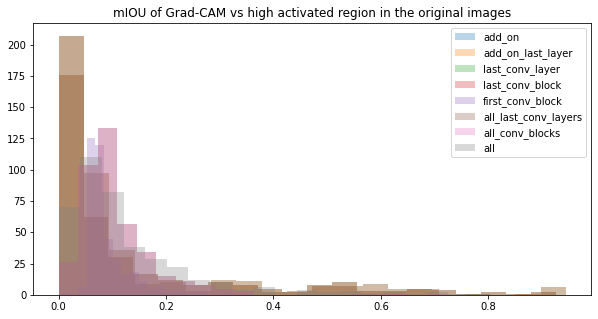

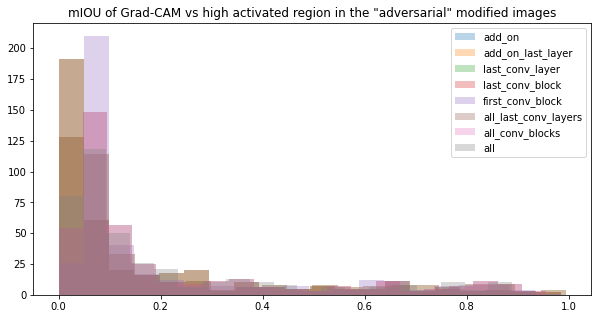

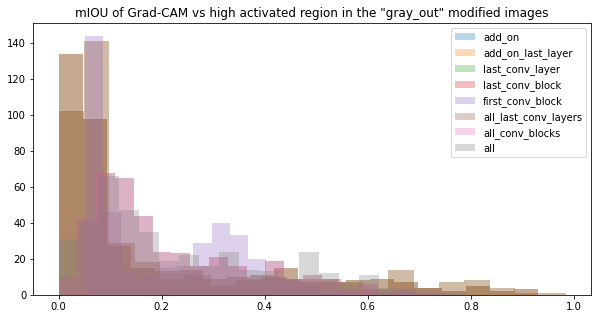

In [5]:
plt.figure(figsize=(10, 5))
for key, iou in iou_original[methods[0]].items():
    plt.hist(iou, bins=20, label=key, alpha=0.3)
plt.title('mIOU of Grad-CAM vs high activated region in the original images')
plt.legend()
plt.show()

for method in methods:
    plt.figure(figsize=(10, 5))
    for key, iou in iou_modified[method].items():
        plt.hist(iou, bins=20, label=key, alpha=0.3)
    plt.title(f'mIOU of Grad-CAM vs high activated region in the "{method}" modified images')
    plt.legend()
    plt.show()

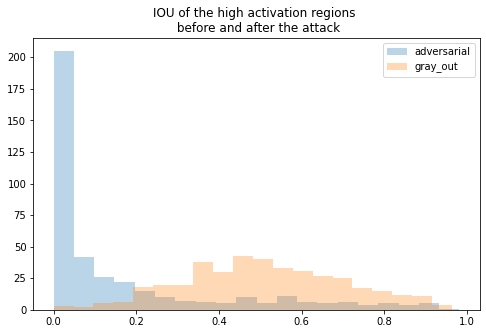

adversarial: mean IOU: 0.16, zero IOU: 46.50%
gray_out: mean IOU: 0.51, zero IOU: 0.25%

Classification accuracy before the attack: 78.25 %
'adversarial': Classification accuracy after the attack:  47.75 %
'gray_out': Classification accuracy after the attack:  36.75 %


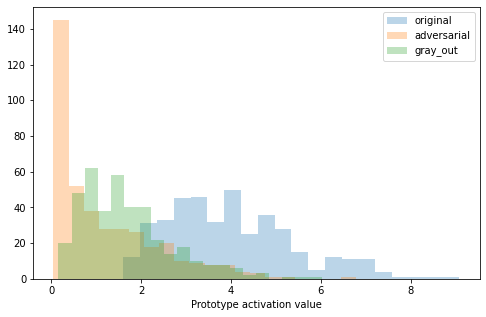

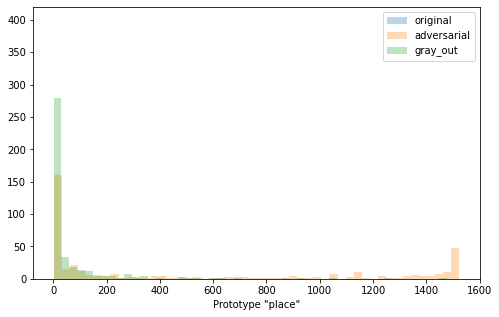


percent prototypes in top 10 before the attack: 100.00 %
adversarial: percent prototypes in top 10 after the attack: 29.75 %
gray_out: percent prototypes in top 10 after the attack: 52.00 %


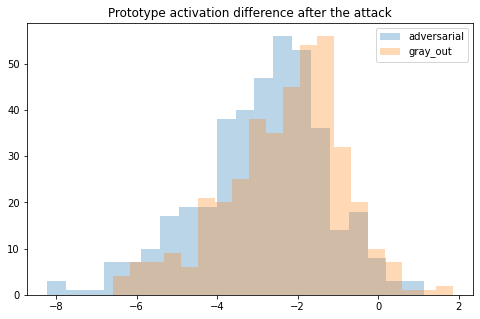

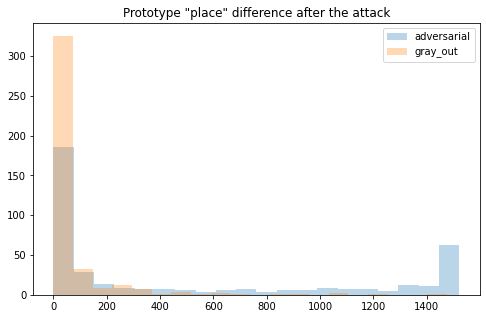

adversarial: Average Prototype 'place' difference after the attack: 499.16
gray_out: Average Prototype 'place' difference after the attack: 64.68


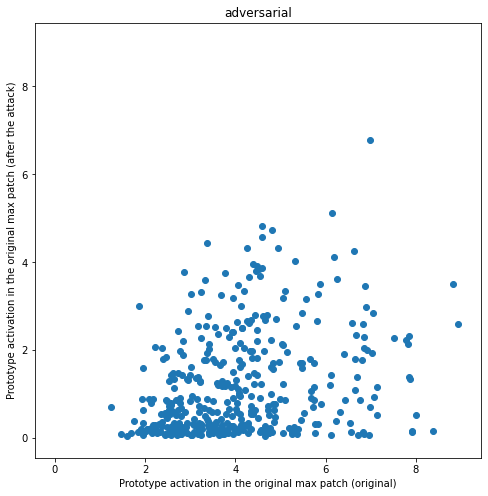

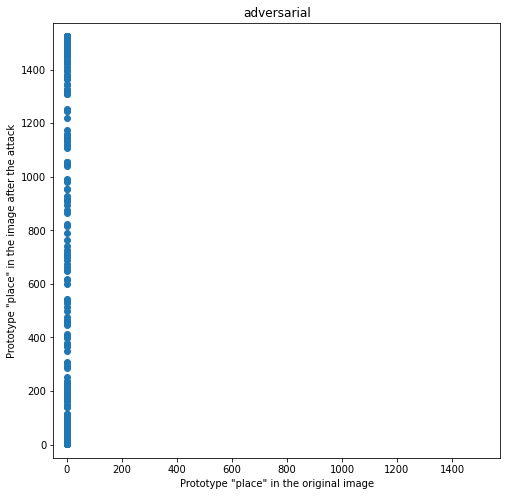

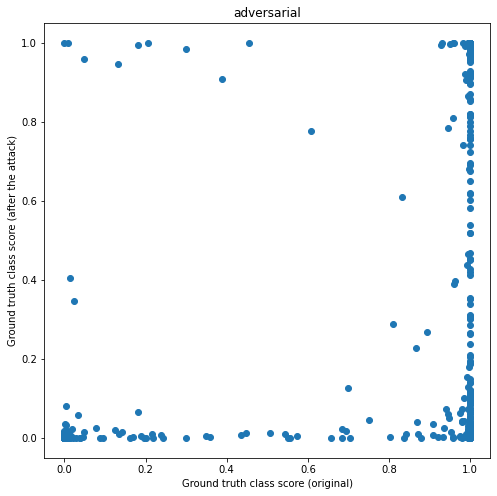

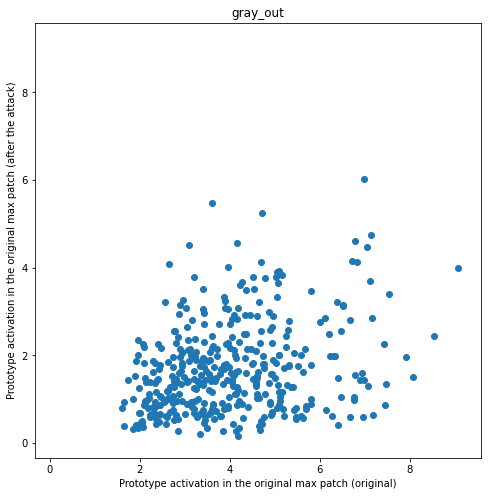

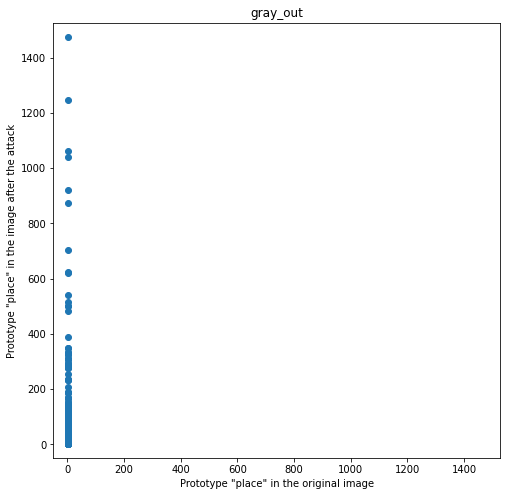

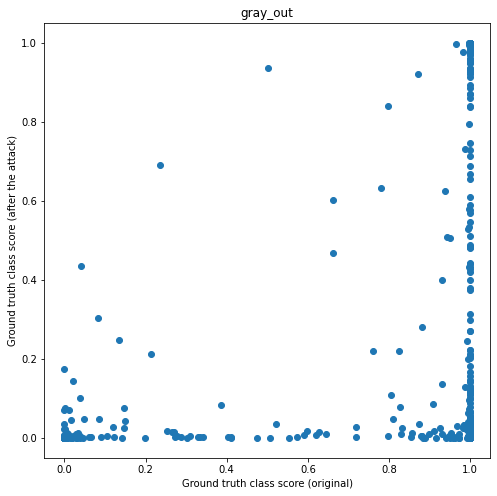

In [6]:
act_before, act_after, act_diff, preds_before, preds_after, preds_diff, place_before, place_after, place_diff = {}, {}, {}, {}, {}, {}, {}, {}, {}
ious = {}


for method in methods:
    all_data = data[method]['data']
    original_acc = data[method]['original_acc']
    modified_acc = data[method]['modified_acc']

    act_before[method] = [d['original_act'] for d in all_data]
    act_after[method] = [d['modified_act'] for d in all_data]

    act_diff[method] = [after - before for after, before in zip(act_after[method], act_before[method])]

    preds_before[method] = [d['original_pred'] for d in all_data]
    preds_after[method] = [d['modified_pred'] for d in all_data]

    place_before[method] = [d['original_proto_place'] for d in all_data]
    place_after[method] = [d['modified_proto_place'] for d in all_data]

    place_diff[method] = [after - before for after, before in zip(place_after[method], place_before[method])]

    ious_method = []
    for idx in range(len(all_data)):
        h1 = all_data[idx]['original_high_act']
        h2 = all_data[idx]['modified_high_act']

        iou = get_iou(
         {
             'x1': h1[0],
             'x2': h1[1],
             'y1': h1[2],
             'y2': h1[3]
         },
         {
             'x1': h2[0],
             'x2': h2[1],
             'y1': h2[2],
             'y2': h2[3]
         }
        )
        ious_method.append(iou)
    ious[method] = np.asarray(ious_method)
    
figsize = (8, 5)
alpha = 0.3

plt.figure(figsize=figsize)
plt.title(f'IOU of the high activation regions \n before and after the attack')
for method in methods:
    plt.hist(ious[method], bins=20, label=method, alpha=alpha)
plt.legend()
plt.show()

for method in methods:
    mean_iou = np.mean(ious[method])
    perc_zero = np.sum(ious[method]==0) / len(ious[method]) * 100
    print(f'{method}: mean IOU: {mean_iou:.2f}, zero IOU: {perc_zero:.2f}%')
    
print(f"\nClassification accuracy before the attack: {data[methods[0]]['original_acc']*100:.2f} %")
for method in methods:
    print(f"'{method}': Classification accuracy after the attack:  {data[method]['modified_acc']*100:.2f} %")

plt.figure(figsize=figsize)
plt.xlabel('Prototype activation value')
plt.hist(act_before[method], bins=20, label='original', alpha=alpha)
for method in methods:
    plt.hist(act_after[method], bins=20, label=method, alpha=alpha)
plt.legend()
plt.show()
    
plt.figure(figsize=figsize)
plt.xlabel('Prototype "place"')
plt.hist(place_before[method], bins=50, label='original', alpha=alpha)
for method in methods:
    plt.hist(place_after[method], bins=50, label=method, alpha=alpha)
plt.legend()
plt.show()

perc_top10 = np.sum((np.asarray(place_before[methods[0]]) < 10)) /len(place_before[methods[0]]) * 100
print(f"\npercent prototypes in top 10 before the attack: {perc_top10:.2f} %")
for method in methods:
    perc_top10 = np.sum((np.asarray(place_after[method]) < 10)) /len(place_after[method]) * 100
    print(f"{method}: percent prototypes in top 10 after the attack: {perc_top10:.2f} %")

plt.figure(figsize=figsize)
for method in methods:
    plt.hist(act_diff[method], bins=20, label=method, alpha=alpha)
plt.title('Prototype activation difference after the attack')
plt.legend()
plt.show()

plt.figure(figsize=figsize)
for method in methods:
    plt.hist(place_diff[method], bins=20, label=method, alpha=alpha)
plt.title('Prototype "place" difference after the attack')
plt.legend()
plt.show()

for method in methods:
    print(f"{method}: Average Prototype 'place' difference after the attack: {np.mean(place_diff[method]):.2f}")
    
for method in methods:
    plt.figure(figsize=(8, 8))
    plt.scatter(act_before[method], act_after[method])
    plt.title(method)
    plt.xlabel('Prototype activation in the original max patch (original)')
    plt.ylabel('Prototype activation in the original max patch (after the attack)')
    plt.xlim([min(min(act_before[method]), min(act_after[method]))-0.5, max(max(act_before[method]), max(act_after[method]))+0.5])
    plt.ylim([min(min(act_before[method]), min(act_after[method]))-0.5, max(max(act_before[method]), max(act_after[method]))+0.5])
    plt.show()

    plt.figure(figsize=(8, 8))
    plt.scatter(place_before[method], place_after[method])
    plt.title(method)
    plt.xlabel('Prototype "place" in the original image')
    plt.ylabel('Prototype "place" in the image after the attack')
    plt.xlim([min(min(place_before[method]), min(place_after[method]))-50, max(max(place_before[method]), max(place_after[method]))+50])
    plt.ylim([min(min(place_before[method]), min(place_after[method]))-50, max(max(place_before[method]), max(place_after[method]))+50])
    plt.show()

    plt.figure(figsize=(8, 8))
    plt.scatter(preds_before[method], preds_after[method])
    plt.title(method)
    plt.xlabel('Ground truth class score (original)')
    plt.ylabel('Ground truth class score (after the attack)')
    plt.xlim([-0.05, 1.05])
    plt.ylim([-0.05, 1.05])
    plt.show()

0.054497220594711605 0.12082690508070279


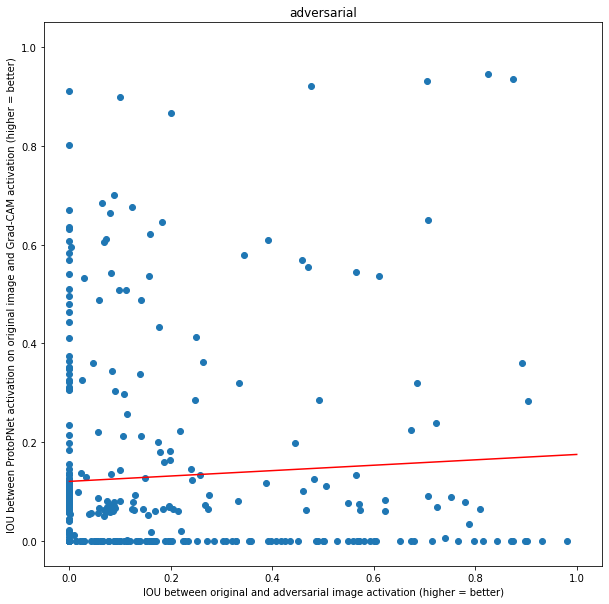

0.12840543038912977 0.04690260176907492


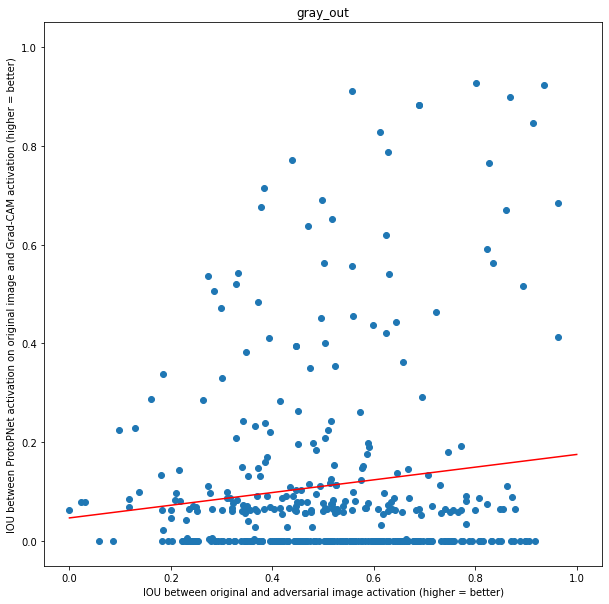

In [7]:
from sklearn.linear_model import LinearRegression

for method in methods:
    regression = LinearRegression()
    regression.fit(np.expand_dims(np.asarray(ious[method]), -1), 
                   np.expand_dims(np.asarray(iou_original[method][best_cam_layers[method]]), -1))
    a = regression.coef_[0][0]
    b = regression.intercept_[0]
    print(a, b)

    plt.figure(figsize=(10, 10))
    plt.scatter(ious[method], iou_original[method][best_cam_layers[method]])
    plt.title(method)
    plt.xlabel('IOU between original and adversarial image activation (higher = better)')
    plt.ylabel('IOU between ProtoPNet activation on original image and Grad-CAM activation (higher = better)')


    x0, x1 = 0, 1
    y0 = a * x0 + b
    y1 = a * x1 + b

    plt.plot([x0, x1], [y0, y1], color='red')
    plt.xlim([-0.05, 1.05])
    plt.ylim([-0.05, 1.05])
    plt.show()

In [8]:
N_SHOW = 20


for method in methods:
    # skip for now
    continue

    
    
    print(method)
    all_data = data[method]['data']
    original_acc = data[method]['original_acc']
    modified_acc = data[method]['modified_acc']

    show_idx = list(sorted(np.random.choice(np.arange(N_SAMPLES), replace=False, size=N_SHOW)))

    plt.figure(figsize=(24, 80))
    # plt.suptitle('Random samples')

    for i, idx in enumerate(show_idx):
        h1 = all_data[idx]['original_high_act']
        h2 = all_data[idx]['modified_high_act']

        iou = get_iou(
         {
             'x1': h1[0],
             'x2': h1[1],
             'y1': h1[2],
             'y2': h1[3]
         },
         {
             'x1': h2[0],
             'x2': h2[1],
             'y1': h2[2],
             'y2': h2[3]
         }
        )

        plt.subplot(20, 6, 6*i+1)
        plt.title(f'original')
        plt.imshow(all_data[idx]['original_img_no_overlay'], vmin=0, vmax=1)
        plt.axis('off')

        ax = plt.subplot(20, 6, 6*i+2)
        plt.title(f'original + heatmap')
        plt.imshow(all_data[idx]['original_img'], vmin=0, vmax=1)
        high_act = all_data[idx]['original_high_act']
        rect = patches.Rectangle((high_act[2], high_act[0]), 
                                  high_act[3]-high_act[2], high_act[1]-high_act[0], 
                                  linewidth=2, edgecolor='y', facecolor='none')
        ax.add_patch(rect)
        plt.axis('off')

        plt.subplot(20, 6, 6*i+3)
        plt.title(f'modified')
        plt.imshow(all_data[idx]['modified_img_no_overlay'], vmin=0, vmax=1)
        plt.axis('off')

        ax = plt.subplot(20, 6, 6*i+4)
        plt.title(f'modified + heatmap\nhigh act iou: {iou:.2f}')
        plt.imshow(all_data[idx]['modified_img'], vmin=0, vmax=1)
        high_act = all_data[idx]['modified_high_act']
        rect = patches.Rectangle((high_act[2], high_act[0]), 
                                  high_act[3]-high_act[2], high_act[1]-high_act[0], 
                                  linewidth=2, edgecolor='y', facecolor='none')
        ax.add_patch(rect)
        plt.axis('off')

        proto_num = all_data[idx]['proto_num']
        proto_path = f'/media/mikolaj/HDD/ml_data/local_prototypes/2022_10_09_resnet_34_layer4/pruned_prototypes_epoch10_k6_pt3/img/epoch-10/prototype-img-original_with_self_act{proto_num}.png'

        img = Image.open(proto_path).convert('RGB')
        img_numpy = np.asarray(img)
        img_numpy = cv2.resize(img_numpy, dsize=(img_size, img_size), interpolation=cv2.INTER_CUBIC)

        plt.subplot(20, 6, 6*i+5)
        plt.title('prototype image')
        plt.imshow(img_numpy, vmin=0, vmax=1)
        plt.axis('off')

        proto_num = all_data[idx]['proto_num']
        proto_path = f'/media/mikolaj/HDD/ml_data/local_prototypes/2022_10_09_resnet_34_layer4/pruned_prototypes_epoch10_k6_pt3/img/epoch-10/prototype-img{proto_num}.png'

        img = Image.open(proto_path).convert('RGB')
        img_numpy = np.asarray(img)
        # img_numpy = cv2.resize(img_numpy, dsize=(img_size, img_size), interpolation=cv2.INTER_CUBIC)

        plt.subplot(20, 6, 6*i+6)
        plt.title('prototype')
        plt.imshow(img_numpy, vmin=0, vmax=1)
        plt.axis('off')

    plt.tight_layout()
    plt.savefig(f'/media/mikolaj/HDD/ml_data/local_prototypes/{method}.png')
    plt.show()

adversarial


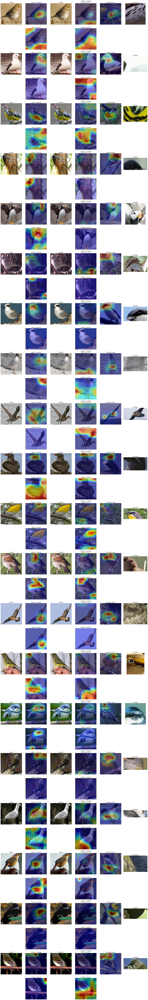

gray_out


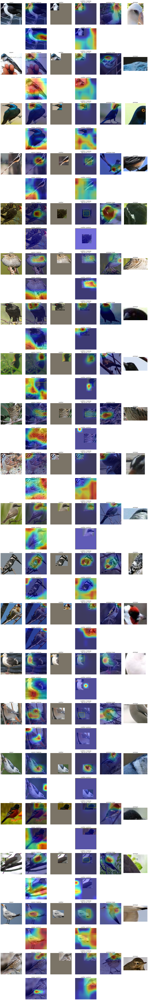

In [9]:
N_SHOW = 20

for method in methods:
    print(method)
    all_data = data[method]['data']
    original_acc = data[method]['original_acc']
    modified_acc = data[method]['modified_acc']

    show_idx = list(sorted(np.random.choice(np.arange(N_SAMPLES), replace=False, size=N_SHOW)))

    plt.figure(figsize=(24, 160))
    # plt.suptitle('Random samples')

    for i, idx in enumerate(show_idx):
        h1 = all_data[idx]['original_high_act']
        h2 = all_data[idx]['modified_high_act']

        iou = get_iou(
         {
             'x1': h1[0],
             'x2': h1[1],
             'y1': h1[2],
             'y2': h1[3]
         },
         {
             'x1': h2[0],
             'x2': h2[1],
             'y1': h2[2],
             'y2': h2[3]
         }
        )

        plt.subplot(N_SHOW * 2, 6, 12*i+1)
        plt.title(f'original')
        plt.imshow(all_data[idx]['original_img_no_overlay'], vmin=0, vmax=1)
        plt.axis('off')

        ax = plt.subplot(N_SHOW * 2, 6, 12*i+2)
        plt.title(f'original + heatmap')
        plt.imshow(all_data[idx]['original_img'], vmin=0, vmax=1)
        high_act = all_data[idx]['original_high_act']
        rect = patches.Rectangle((high_act[2], high_act[0]), 
                                  high_act[3]-high_act[2], high_act[1]-high_act[0], 
                                  linewidth=2, edgecolor='y', facecolor='none')
        ax.add_patch(rect)
        plt.axis('off')

        plt.subplot(N_SHOW * 2, 6, 12*i+3)
        plt.title(f'modified')
        plt.imshow(all_data[idx]['modified_img_no_overlay'], vmin=0, vmax=1)
        plt.axis('off')

        ax = plt.subplot(N_SHOW * 2, 6, 12*i+4)
        plt.title(f'modified + heatmap\nhigh act iou: {iou:.2f}')
        plt.imshow(all_data[idx]['modified_img'], vmin=0, vmax=1)
        high_act = all_data[idx]['modified_high_act']
        rect = patches.Rectangle((high_act[2], high_act[0]), 
                                  high_act[3]-high_act[2], high_act[1]-high_act[0], 
                                  linewidth=2, edgecolor='y', facecolor='none')
        ax.add_patch(rect)
        plt.axis('off')

        proto_num = all_data[idx]['proto_num']
        proto_path = f'/media/mikolaj/HDD/ml_data/local_prototypes/2022_10_09_resnet_34_layer4/pruned_prototypes_epoch10_k6_pt3/img/epoch-10/prototype-img-original_with_self_act{proto_num}.png'

        img = Image.open(proto_path).convert('RGB')
        img_numpy = np.asarray(img)
        img_numpy = cv2.resize(img_numpy, dsize=(img_size, img_size), interpolation=cv2.INTER_CUBIC)

        plt.subplot(N_SHOW * 2, 6, 12*i+5)
        plt.title('prototype image')
        plt.imshow(img_numpy, vmin=0, vmax=1)
        plt.axis('off')

        proto_num = all_data[idx]['proto_num']
        proto_path = f'/media/mikolaj/HDD/ml_data/local_prototypes/2022_10_09_resnet_34_layer4/pruned_prototypes_epoch10_k6_pt3/img/epoch-10/prototype-img{proto_num}.png'

        img = Image.open(proto_path).convert('RGB')
        img_numpy = np.asarray(img)
        # img_numpy = cv2.resize(img_numpy, dsize=(img_size, img_size), interpolation=cv2.INTER_CUBIC)

        plt.subplot(N_SHOW * 2, 6, 12*i+6)
        plt.title('prototype')
        plt.imshow(img_numpy, vmin=0, vmax=1)
        plt.axis('off')

        ax = plt.subplot(N_SHOW * 2, 6, 12*i+8)
        plt.title('original - gradcam')
        plt.imshow(all_data[idx]['original_cam'][best_cam_layers[method]]['img'], vmin=0, vmax=1)
        high_act = all_data[idx]['original_cam'][best_cam_layers[method]]['high_act']
        rect = patches.Rectangle((high_act[2], high_act[0]), 
                                  high_act[3]-high_act[2], high_act[1]-high_act[0], 
                                  linewidth=2, edgecolor='y', facecolor='none')
        ax.add_patch(rect)
        plt.axis('off')


        ax = plt.subplot(N_SHOW * 2, 6, 12*i+10)
        plt.title('modified - gradcam')
        plt.imshow(all_data[idx]['modified_cam'][best_cam_layers[method]]['img'], vmin=0, vmax=1)
        high_act = all_data[idx]['modified_cam'][best_cam_layers[method]]['high_act']
        rect = patches.Rectangle((high_act[2], high_act[0]), 
                                  high_act[3]-high_act[2], high_act[1]-high_act[0], 
                                  linewidth=2, edgecolor='y', facecolor='none')
        ax.add_patch(rect)
        plt.axis('off')    

    plt.tight_layout()
    plt.savefig(f'/media/mikolaj/HDD/ml_data/local_prototypes/{method}_grad_cam.png')
    plt.show()

# TODO
- normalizowac heatmape aktywacji prototypow tak samo w original i modified
- zrobic lepsze statystyki odnosnie zmian przed i po modyfikacji
- moze nie jest potrzebne az takie zaszumianie - moze juz wczesniej schodza do zera tylko teraz nie widac przez normalizacje
    - moze da sie naprawde adwersarialnie zaszumic
    - sprobuj naprawde klasycznie adwersarialnie (niewidoczne golym okiem) zaszumic. Mozesz zaszumic wszystko oprocz prostokata wysokiej aktywacji
- dodac pokazanie oryginalnego prototypu obok wizualizacji
- (opcjonalnie) ramka wokol obrazka (3-4 piksele)
- obczaj https://arxiv.org/pdf/2105.02968.pdf
- poszukaj jakie sa metody adwersarialne


24.11.2022:
- Grad-CAM

Na nastepny raz:
 - proste mierzenie gradientu na wejsciu
 - Layer-wise relevance propagation 
 - Pokazać Grad-CAMa (albo inna metode) na wyjsciu, i czy zgadza sie z aktywacja prototypow klasy
 - Zaatakowac adwersarialnie tylko miejsce wysokiej aktywacji Grad-CAMa
     - użyć tego eksperymentu do znalezienia najlepiej dzialajacej metody do znajdowania ka(porownac np z LRP, gradient wejscia itd)